# Automating Port Operations

The company’s management has set out to build a bias-free/ corruption-free automatic system that reports & avoids faulty situations caused by human error. Examples of human error include misclassifying the correct type of boat. The type of boat that enters the port region is as follows.
-	Buoy
-	Cruise_ship
-	Ferry_boat
-	Freight_boar
-	Gondola
-	Inflatable_boat
-	Kayak
-	Paper_boat
-	Sailboat

Use **Deep Learning** techniques to build an automatic reporting system that recognizes the boat. The company is also looking to use a **transfer learning** approach of any lightweight pre-trained model in order to deploy in mobile devices.

### Import required libraries

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import utils
import PIL
import datetime, os

%load_ext tensorboard
%matplotlib inline

### Connect to the dataset

In [ ]:
# Uncomment below code if your dataset is located on Google drive
# This will mount the drive on Colab

# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Uncomment below code if you are reading images from a zipped file
# Change the file path to your directory where the zip file containing images is located

# import zipfile

# zip_images = zipfile.ZipFile('/content/drive/MyDrive/Automating_Port_Operations_dataset.zip','r')
# zip_images.extractall('/content/' )
# zip_images.close()

##### Create the data_dir variable from where we can read our images

In [ ]:
# Change the path to your folder which contains the unzipped images

import pathlib
data_dir = pathlib.Path('/content/Automating_Port_Operations_dataset')
data_dir

PosixPath('/content/Automating_Port_Operations_dataset')

### Analyzing the images present in the dataset

#### Total number of images in the dataset

In [ ]:
len(list(data_dir.glob('*/*.jpg')))

1162

#### View images in a few folders

In [ ]:
# Get list of sailboats
sailboat = list(data_dir.glob('sailboat/*'))

# Number of sailboats
print('Number of sailboat images: ', len(sailboat))

Number of sailboat images:  389


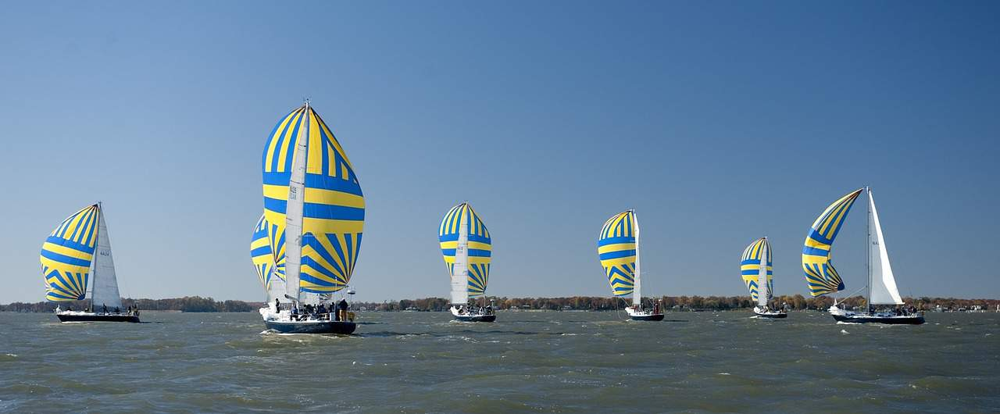

In [ ]:
# Display sample sailboat image
PIL.Image.open(str(sailboat[1]))

In [ ]:
# Get list of inflatable boats
inflatable_boat = list(data_dir.glob('inflatable_boat/*'))

# Number of sailboats
print('Number of inflatable boat images: ', len(inflatable_boat))

Number of inflatable boat images:  16


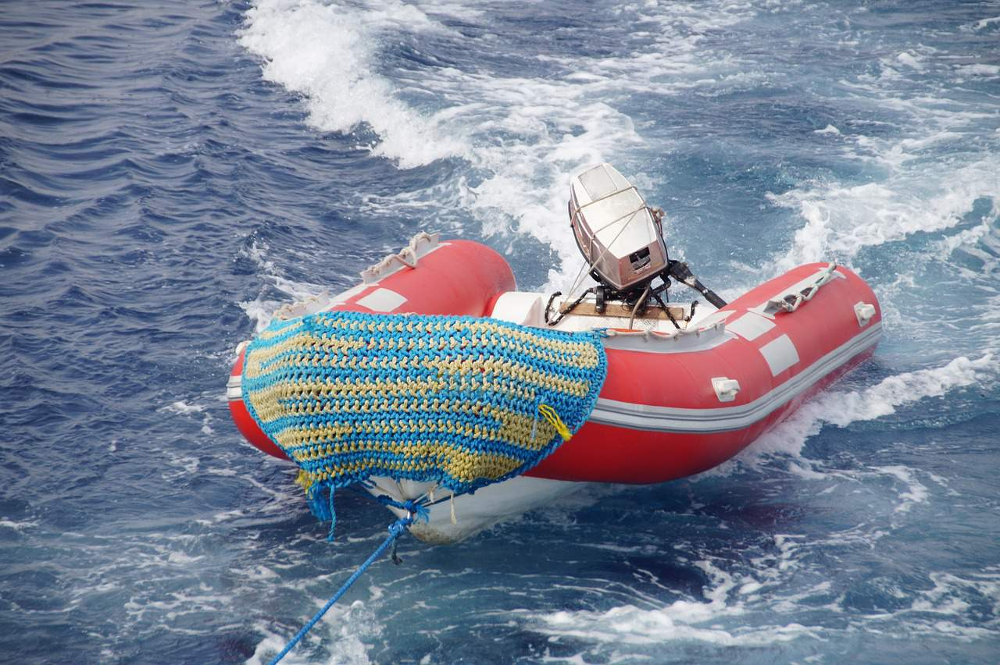

In [ ]:
# Display sample inflatable boat image
PIL.Image.open(str(inflatable_boat[1]))

###Data Loading
- Split the dataset into train and test in the ratio 80:20, with shuffle and random state=43.
- Use tf.keras.preprocessing.image_dataset_from_directory to load the train and test datasets. This function also supports data normalization.
- Load train, validation and test dataset in batches of 32 using the function initialized in the above step.


In [ ]:
# Create variables to specify image size (height, width) and batch size
image_size = (224, 224)
batch_size = 32

# Creating train and test datasets
train_ds, val_ds = utils.image_dataset_from_directory(
    data_dir,
    image_size = image_size,
    batch_size = batch_size,
    validation_split = 0.2,
    seed = 43,
    subset='both',
    shuffle=True
)

Found 1162 files belonging to 9 classes.
Using 930 files for training.
Using 232 files for validation.


- Generating test dataset by choosing the number of test samples (20%) from the validation dataset

In [ ]:
test_ds = val_ds.take(5)
val_ds = val_ds.skip(5)

In [ ]:
# Print train, validation and test sizes
print('Number of images in training dataset:')
print(len(np.concatenate([i for x, i in train_ds], axis=0)))

print('Number of images in validation dataset:')
print(len(np.concatenate([i for x, i in val_ds], axis=0)))

print('Number of images in test dataset:')
print(len(np.concatenate([i for x, i in test_ds], axis=0)))

Number of images in training dataset:
930
Number of images in validation dataset:
72
Number of images in test dataset:
160


#### Visualize the training data

Image labels:  ['buoy', 'cruise_ship', 'ferry_boat', 'freight_boat', 'gondola', 'inflatable_boat', 'kayak', 'paper_boat', 'sailboat']
Sample images from train dataset:


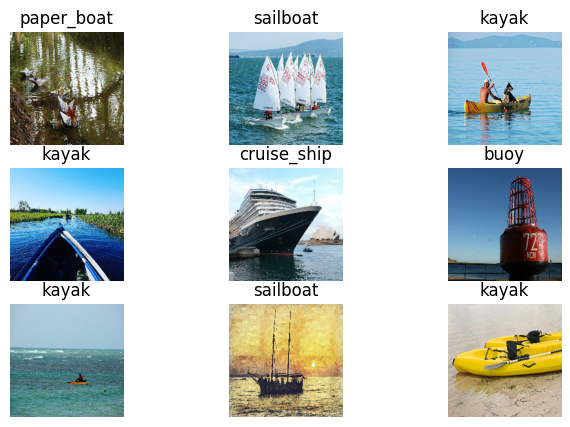

In [ ]:
# Fetch the unique image labels
class_names = train_ds.class_names
print('Image labels: ', class_names)


# Plotting the first 9 images in the train dataset

print('Sample images from train dataset:')
plt.figure(figsize=(8,5))
for images, labels in train_ds.take(1):
  for i in range (9):
    axes = plt.subplot(3, 3, i+1)
    plt.imshow(images[i].numpy().astype('uint8'))
    plt.title(class_names[labels[i]])
    plt.axis('off')

Sample images from validation dataset:


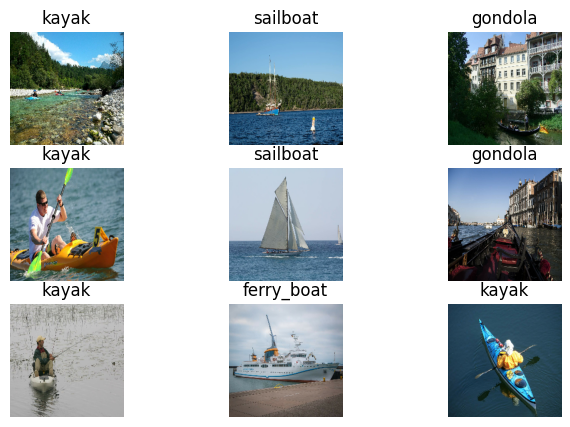

In [ ]:
# Plotting the first 9 images in the validation dataset

print('Sample images from validation dataset:')
plt.figure(figsize=(8,5))
for images, labels in val_ds.take(1):
  for i in range (9):
    axes = plt.subplot(3, 3, i+1)
    plt.imshow(images[i].numpy().astype('uint8'))
    plt.title(class_names[labels[i]])
    plt.axis('off')

Sample images from test dataset:


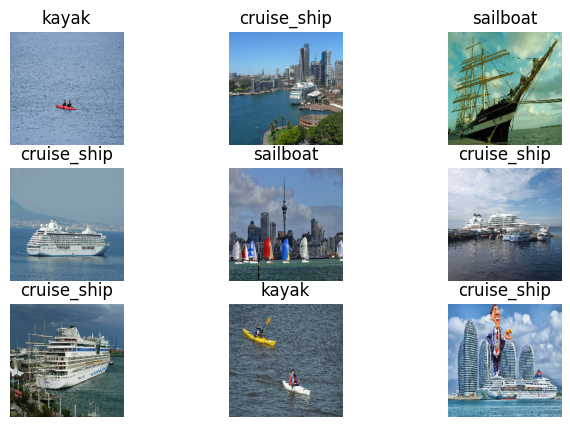

In [ ]:
# Plotting the first 9 images in the test dataset

print('Sample images from test dataset:')
plt.figure(figsize=(8,5))
for images, labels in test_ds.take(1):
  for i in range (9):
    axes = plt.subplot(3, 3, i+1)
    plt.imshow(images[i].numpy().astype('uint8'))
    plt.title(class_names[labels[i]])
    plt.axis('off')

### Configure the dataset for performance

In [ ]:
# Set up caching, pre-fetching of images in buffer

AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)
test_ds = test_ds.cache().prefetch(buffer_size=AUTOTUNE)

### Using image data augmentation
Since we don't have a large image dataset, let's artificially introduce sample diversity by applying random yet realistic transformations to the training images, such as random horizontal flipping or small random rotations. This will help expose the model to different aspects of the training data while slowing down overfitting.

In [ ]:
# Create the data augmentation layers
augmented_layers =  [
    layers.RandomFlip('horizontal', input_shape = (224,224,3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
]

#### Visualizing augmentation for sample images

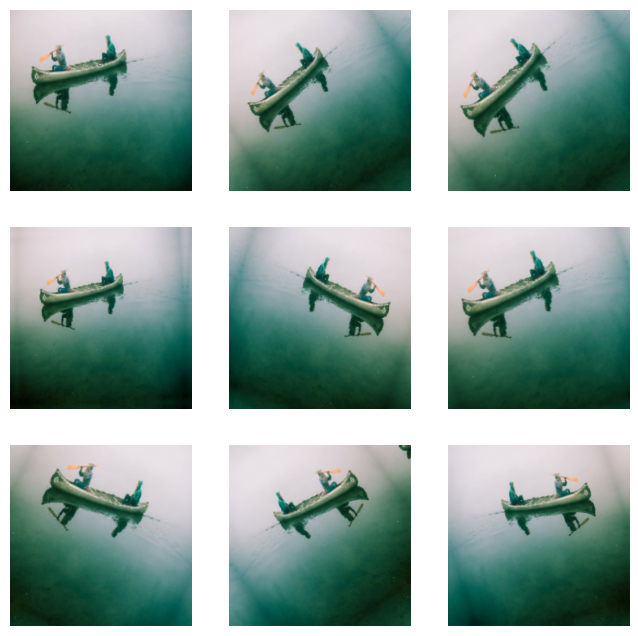

In [ ]:
# Define an augmentation function
def data_augmentation_fn(images):
  for layer in augmented_layers:
    images = layer(images)
  return images

# Plot the images
plt.figure(figsize=(8,8))
for images, labels in train_ds.take(1):
  for i in range(9):
    aug_imgs = data_augmentation_fn(images)
    axes = plt.subplot(3,3,i+1)
    plt.imshow(aug_imgs[1].numpy().astype('uint8'))
    plt.axis('off')

#Model 1: Build a CNN network using Keras from scratch

#### Create layers

In [ ]:
model = Sequential([
# Input layer
layers.Input(shape=(224,224,3)),
# Data augmentation layers
layers.RandomFlip('horizontal'),
layers.RandomRotation(0.1),
layers.RandomZoom(0.1),
# Data Normalization
layers.Rescaling(1./255),
# Convolution 1
layers.Conv2D(32, 3, activation='relu', padding='same'),
# Pooling layer 1
layers.MaxPooling2D(),
# Convolution 2
layers.Conv2D(32, 3, activation='relu', padding='same'),
# Pooling layer 2
layers.MaxPooling2D(),
# Pooling layer 3
layers.GlobalAveragePooling2D(),
# Dropout
layers.Dropout(0.2),
# Flatten
layers.Flatten(),
# Dense layer 1
layers.Dense(128, activation='relu'),
# Dense layer 2
layers.Dense(128, activation='relu'),
# Output layer
layers.Dense(9, activation='softmax')
])

#### View the Model

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 random_flip_1 (RandomFlip)  (None, 224, 224, 3)       0         
                                                                 
 random_rotation_1 (RandomR  (None, 224, 224, 3)       0         
 otation)                                                        
                                                                 
 random_zoom_1 (RandomZoom)  (None, 224, 224, 3)       0         
                                                                 
 rescaling (Rescaling)       (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 112, 112, 32)      0         
 D)                                                     

## Compile the model

In [ ]:
model.compile(optimizer = 'adam',
              loss = keras.losses.SparseCategoricalCrossentropy(),
              metrics = ['accuracy'])

## Create TensorBoard callback for visualizations

In [ ]:
logdir = os.path.join("logs1", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

## Train the model

In [ ]:
epochs = 20

history = model.fit(train_ds,
          epochs=epochs,
          validation_data=val_ds,
          callbacks=[tensorboard_callback]
                    )

Epoch 1/20
30/30 [==============================] - 76s 2s/step - loss: 1.9093 - accuracy: 0.3204 - val_loss: 1.8550 - val_accuracy: 0.3056
Epoch 2/20
30/30 [==============================] - 67s 2s/step - loss: 1.8201 - accuracy: 0.3430 - val_loss: 1.8427 - val_accuracy: 0.3056
Epoch 3/20
30/30 [==============================] - 66s 2s/step - loss: 1.8202 - accuracy: 0.3430 - val_loss: 1.8343 - val_accuracy: 0.3056
Epoch 4/20
30/30 [==============================] - 66s 2s/step - loss: 1.8042 - accuracy: 0.3430 - val_loss: 1.8340 - val_accuracy: 0.3056
Epoch 5/20
30/30 [==============================] - 74s 2s/step - loss: 1.8059 - accuracy: 0.3430 - val_loss: 1.8289 - val_accuracy: 0.3056
Epoch 6/20
30/30 [==============================] - 67s 2s/step - loss: 1.7970 - accuracy: 0.3430 - val_loss: 1.8287 - val_accuracy: 0.3056
Epoch 7/20
30/30 [==============================] - 69s 2s/step - loss: 1.7918 - accuracy: 0.3430 - val_loss: 1.8281 - val_accuracy: 0.3056
Epoch 8/20
30/30 [==

## Plot training loss and accuracy against epochs.
Creating plots of the loss and accuracy on the training and validation sets:

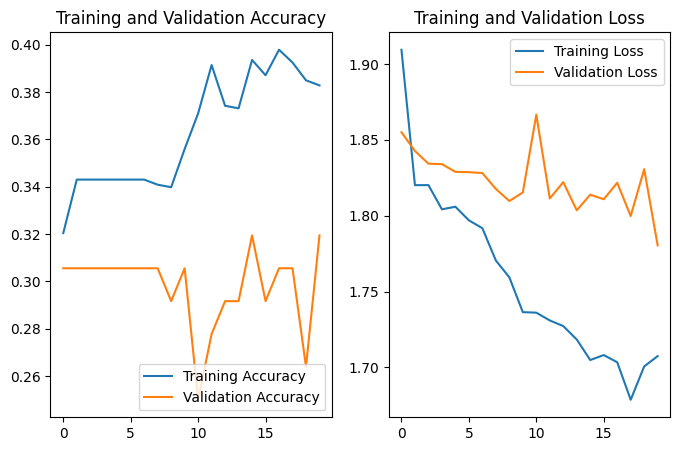

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8,5))

plt.subplot(1,2,1)
plt.plot(range(epochs), acc, label='Training Accuracy')
plt.plot(range(epochs), val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')


plt.subplot(1,2,2)
plt.plot(range(epochs), loss, label='Training Loss')
plt.plot(range(epochs), val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

- The gap between traning and validation loss and accuracy is quite large.
- This indicates a problem of model overfitting.

##Evaluate the model on test images and print the test loss and accuracy.
Using Keras Model.evaluate to get the loss and accuracy on the test dataset.

In [ ]:
test_eval = model.evaluate(test_ds, verbose=0) # verbose = 0 suppresses the evaluation output

print('Test loss: {:.2f}'.format(test_eval[0]))
print('Test accuracy: {:.2f}%'.format(test_eval[1]*100))

Test loss: 1.69
Test accuracy: 31.25%


*****
####We see that, on constructing a CNN from scratch we were able to achieve an accuracy of **31.25%** on the test dataset.
*****

### Make predictions

In [ ]:
# Define a function to predict the probabilities of each of the 9 classes

def get_actual_predicted_labels(dataset):
  actual = [label for img, label in dataset.unbatch()]
  preds = model.predict(dataset)

  actual = tf.stack(actual, axis=0)
  predicted = tf.concat(preds, axis=0)
  predicted = tf.argmax(predicted, axis=1) # Select the class with the maximum probability as the final prediction

  return actual, predicted

In [ ]:
# Use the function to get predicted probabilities on test data

actual, predictions = get_actual_predicted_labels(test_ds)

5/5 [==============================] - 4s 638ms/step


###Plot heatmap of the confusion matrix and print classification report.

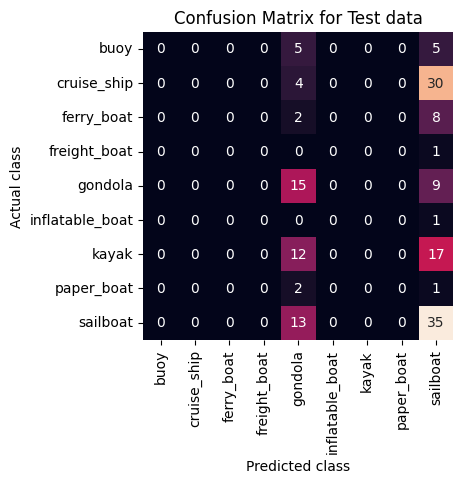

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

# Confusion matrix
cm = tf.math.confusion_matrix(actual, predictions)

plt.figure(figsize=(4,4))
ax = sns.heatmap(cm, annot=True, fmt='g', cbar=False)
plt.xticks(rotation=90)
plt.yticks(rotation=0)
ax.xaxis.set_ticklabels(class_names)
ax.yaxis.set_ticklabels(class_names)

plt.xlabel("Predicted class")
plt.ylabel("Actual class")
plt.title("Confusion Matrix for Test data")
plt.show()


1. We see that there are multiple boats that are incorrectly classified:
 - Cruise ship has been classified as sail boay 22 times
 - Sail boat has been classsified as gondola 17 times

2. The model predicts Gondola and Sailboat maximum times which indicates that despite data augmentation, the class imbalance during training has likely caused the model to overfit.

In [ ]:
# Classification Report

import warnings
import pandas as pd
warnings.filterwarnings('ignore')

print('Classification Report:\n')
pd.DataFrame(classification_report(actual, predictions, target_names=class_names, output_dict=True)).T

Classification Report:



,precision,recall,f1-score,support
buoy,0.000000,0.000000,0.000000,10.0000
cruise_ship,0.000000,0.000000,0.000000,34.0000
ferry_boat,0.000000,0.000000,0.000000,10.0000
freight_boat,0.000000,0.000000,0.000000,1.0000
gondola,0.283019,0.625000,0.389610,24.0000
inflatable_boat,0.000000,0.000000,0.000000,1.0000
kayak,0.000000,0.000000,0.000000,29.0000
paper_boat,0.000000,0.000000,0.000000,3.0000
sailboat,0.327103,0.729167,0.451613,48.0000
accuracy,0.312500,0.312500,0.312500,0.3125


# Model 2.1: Build a CNN network using transfer learning

- Build a CNN network using a lightweight pre-trained model as the first layer.

- Lightweight models are good for deploying the solution on a mobile device using transfer learning. MobileNetV2 is a popular lightweight pre-trained model built using Keras API.

####Download the pretrained base model

In [ ]:
# Instantiating base light weight model with pre-trained weights

base_model = keras.applications.MobileNetV2(
    weights = 'imagenet', # Load weights that were pre-trained on imgagenet database
    input_shape = (224, 224, 3),
    include_top = False # Remove the last layer of ImageNet classifier which is the output layer
)

9406464/9406464 [==============================] - 1s 0us/step


#### Freeze the base model

In [ ]:
base_model.trainable = False

#### Create the layers

In [ ]:
# Data Augmentation
inputs = layers.Input(shape=(224,224,3))

# Augmentation
x = layers.RandomFlip('horizontal')(inputs)
x = layers.RandomRotation(0.1)(x)
x = layers.RandomZoom(0.1)(x)

# Rescaling
x = layers.Rescaling(1./255)(x)

# Add the base pretrained model, set training=false explicitly so that
# the model does not train even when we unfreeze it for finetuning
x = base_model(x, training=False)

# Add remaining layers
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dropout(0.2)(x)
x = layers.Dense(256, activation='relu')(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.1)(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.1)(x)
outputs = layers.Dense(9, activation='softmax')(x)


#### Build the model

In [ ]:
model = Model(inputs, outputs)

#### View the model

In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 random_flip_2 (RandomFlip)  (None, 224, 224, 3)       0         
                                                                 
 random_rotation_2 (RandomR  (None, 224, 224, 3)       0         
 otation)                                                        
                                                                 
 random_zoom_2 (RandomZoom)  (None, 224, 224, 3)       0         
                                                                 
 rescaling_1 (Rescaling)     (None, 224, 224, 3)       0         
                                                                 
 mobilenetv2_1.00_224 (Func  (None, 7, 7, 1280)        2257984   
 tional)                                                     

#### Compile the model

In [ ]:
model.compile(optimizer = 'adam',
              loss = keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

#### Define Callbacks

In [ ]:
# TensorBorad callback
logdir = os.path.join("logs2_1", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

# Early stopping
earlystopping_callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)

#### Train the model

In [ ]:
epochs=50

training = model.fit(train_ds, epochs=epochs, validation_data = val_ds, callbacks = [earlystopping_callback, tensorboard_callback])

Epoch 1/50
30/30 [==============================] - 61s 2s/step - loss: 1.5345 - accuracy: 0.5452 - val_loss: 0.8965 - val_accuracy: 0.7361
Epoch 2/50
30/30 [==============================] - 55s 2s/step - loss: 0.7213 - accuracy: 0.7785 - val_loss: 0.6952 - val_accuracy: 0.7361
Epoch 3/50
30/30 [==============================] - 52s 2s/step - loss: 0.5359 - accuracy: 0.8376 - val_loss: 0.6051 - val_accuracy: 0.7500
Epoch 4/50
30/30 [==============================] - 55s 2s/step - loss: 0.4805 - accuracy: 0.8409 - val_loss: 0.6429 - val_accuracy: 0.7639
Epoch 5/50
30/30 [==============================] - 53s 2s/step - loss: 0.3683 - accuracy: 0.8849 - val_loss: 0.5712 - val_accuracy: 0.8056
Epoch 6/50
30/30 [==============================] - 55s 2s/step - loss: 0.3404 - accuracy: 0.8839 - val_loss: 0.6362 - val_accuracy: 0.7917
Epoch 7/50
30/30 [==============================] - 56s 2s/step - loss: 0.3130 - accuracy: 0.9054 - val_loss: 0.5717 - val_accuracy: 0.8056
Epoch 8/50
30/30 [==

- We have achieved a validation accuracy > **80%** using the pretrained model MobileNetv2.
- Validation accuracy of the model that we created from scratch was 31%.
- So far, the pre-trained model is faring better.:

####Plot the loss and accuracy

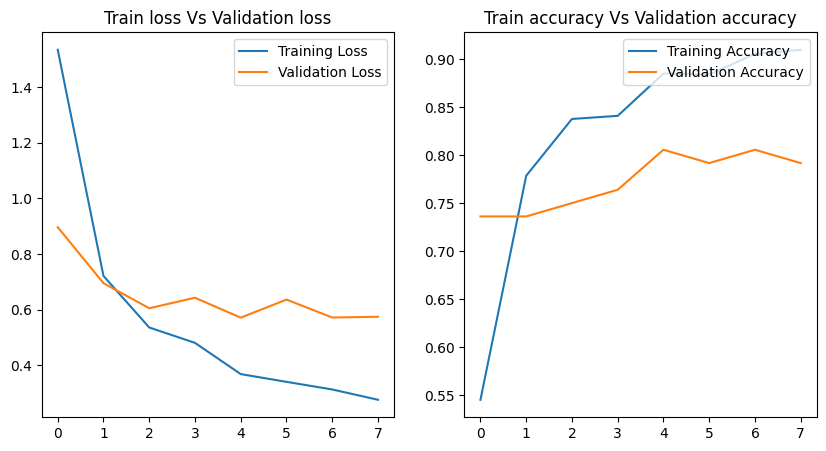

In [ ]:
train_loss = training.history['loss']
val_loss = training.history['val_loss']

train_acc = training.history['accuracy']
val_acc = training.history['val_accuracy']


# Plot the graphs
plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.plot( train_loss, label='Training Loss')
plt.plot( val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Train loss Vs Validation loss')

plt.subplot(1,2,2)
plt.plot( train_acc, label='Training Accuracy')
plt.plot( val_acc, label='Validation Accuracy')
plt.legend(loc='upper right')
plt.title('Train accuracy Vs Validation accuracy')

plt.show()

- At the end of training, the loss and accuracy gap between training and validation set has reduced.
- Model overfitting has been contained to some extent.

##Evaluating the test dataset

In [ ]:
test_eval = model.evaluate(test_ds)


print('PRE-TRAINED MODEL')
print('---------------------------')
print('Test loss: {:.2f}'.format(test_eval[0]))
print('Test accuracy: {:.2f}%'.format(test_eval[1]*100))

5/5 [==============================] - 6s 1s/step - loss: 0.7286 - accuracy: 0.8125
PRE-TRAINED MODEL
---------------------------
Test loss: 0.73
Test accuracy: 81.25%


*****
####We see that, on constructing a CNN from a pre-trained model we were able to achieve an accuracy of **81.25%** on the test dataset.
*****

Other observations:
- We observe that validation accuracy at the last epoc is lesser than training accuracy.
- It indicates that our model has slightly overfit the training data.
- Let's reduce the complexity of the model by reducing the number of layers to avoid overfitting.

# Model 2.2: Transfer learning - fewer layers

We will reuse the same code above and simple reduct the number of layers while building the model

Epoch 1/50
30/30 [==============================] - 61s 2s/step - loss: 1.7129 - accuracy: 0.4591 - val_loss: 1.2112 - val_accuracy: 0.6389
Epoch 2/50
30/30 [==============================] - 53s 2s/step - loss: 0.9720 - accuracy: 0.6968 - val_loss: 0.9043 - val_accuracy: 0.7083
Epoch 3/50
30/30 [==============================] - 52s 2s/step - loss: 0.7404 - accuracy: 0.7677 - val_loss: 0.7294 - val_accuracy: 0.7222
Epoch 4/50
30/30 [==============================] - 52s 2s/step - loss: 0.6445 - accuracy: 0.7828 - val_loss: 0.6621 - val_accuracy: 0.7222
Epoch 5/50
30/30 [==============================] - 52s 2s/step - loss: 0.5719 - accuracy: 0.8086 - val_loss: 0.6101 - val_accuracy: 0.7222
Epoch 6/50
30/30 [==============================] - 53s 2s/step - loss: 0.5138 - accuracy: 0.8366 - val_loss: 0.5922 - val_accuracy: 0.7778
Epoch 7/50
30/30 [==============================] - 55s 2s/step - loss: 0.4647 - accuracy: 0.8441 - val_loss: 0.5639 - val_accuracy: 0.8056
Epoch 8/50
30/30 [==

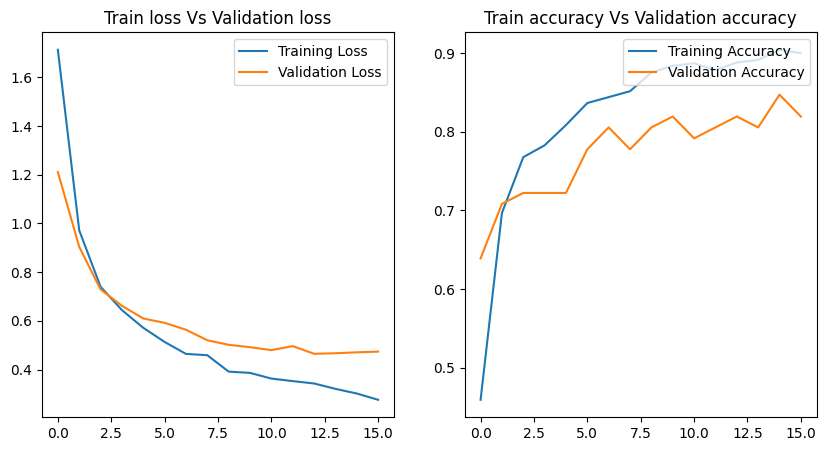



5/5 [==============================] - 6s 1s/step - loss: 0.5462 - accuracy: 0.8438
PRE-TRAINED MODEL (fewer layers)
---------------------------
Test loss: 0.55
Test accuracy: 84.38%


In [ ]:
# Build the model

inputs = layers.Input(shape=(224,224,3))
x = layers.RandomFlip('horizontal')(inputs)
x = layers.RandomRotation(0.1)(x)
x = layers.RandomZoom(0.1)(x)
x = layers.Rescaling(1./255)(x)
x = base_model(x, training=False)
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dropout(0.2)(x)
outputs = layers.Dense(9, activation='softmax')(x)
model = Model(inputs, outputs)
model.compile(optimizer = 'adam',
              loss = keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

# Callbacks
logdir = os.path.join("logs2_2", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
earlystopping_callback = keras.callbacks.EarlyStopping(monitor='val_loss', patience=3)


# Training
epochs=50
training = model.fit(train_ds, epochs=epochs, validation_data = val_ds, callbacks = [earlystopping_callback, tensorboard_callback])


# Plot accuracy and loss
train_loss = training.history['loss']
val_loss = training.history['val_loss']
train_acc = training.history['accuracy']
val_acc = training.history['val_accuracy']

print('\n')
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.plot( train_loss, label='Training Loss')
plt.plot( val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Train loss Vs Validation loss')
plt.subplot(1,2,2)
plt.plot( train_acc, label='Training Accuracy')
plt.plot( val_acc, label='Validation Accuracy')
plt.legend(loc='upper right')
plt.title('Train accuracy Vs Validation accuracy')
plt.show()
print('\n')

# Evaluate the test data
test_eval = model.evaluate(test_ds)
print('PRE-TRAINED MODEL (fewer layers)')
print('---------------------------')
print('Test loss: {:.2f}'.format(test_eval[0]))
print('Test accuracy: {:.2f}%'.format(test_eval[1]*100))

*****
####We see that, on constructing a CNN from a pre-trained model we were able to achieve an accuracy of **84.38%** on the test dataset.
*****

# Model 3: Fine tuning the pre-trained model

Let's see if we can improve the accuracy further by fine-tuning the base model. This involves unfreezing the MobileNetv2 model and retraininng it.
Note however that since we have set ***training=false***, the pretrained model will still in inference mode.

#### Unfreeze the base model

In [ ]:
# Note that since set 'training=False' while creating the model, the base model will still run in inference mode.
# i.e. it will not update it's batch normalization weights even after defreezing.

base_model.trainable = True

#### View the model

In [ ]:
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 random_flip_3 (RandomFlip)  (None, 224, 224, 3)       0         
                                                                 
 random_rotation_3 (RandomR  (None, 224, 224, 3)       0         
 otation)                                                        
                                                                 
 random_zoom_3 (RandomZoom)  (None, 224, 224, 3)       0         
                                                                 
 rescaling_2 (Rescaling)     (None, 224, 224, 3)       0         
                                                                 
 mobilenetv2_1.00_224 (Func  (None, 7, 7, 1280)        2257984   
 tional)                                                   

####Compile the model
Let's compile the model with a very low learning rate

In [ ]:
model.compile(optimizer = keras.optimizers.Adam(1e-5), # Passing a very low learning rate
              loss = keras.losses.SparseCategoricalCrossentropy(),
              metrics = ['accuracy']
              )

####Callbacks

In [ ]:
# TensorBorad callback
logdir = os.path.join("logs3", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

####Training the end-to-end model

In [ ]:
epochs = 10
training = model.fit(train_ds, epochs=epochs, validation_data = val_ds, callbacks=[tensorboard_callback])

Epoch 1/10
30/30 [==============================] - 168s 5s/step - loss: 0.2809 - accuracy: 0.9032 - val_loss: 0.4827 - val_accuracy: 0.8056
Epoch 2/10
30/30 [==============================] - 145s 5s/step - loss: 0.2510 - accuracy: 0.9183 - val_loss: 0.4096 - val_accuracy: 0.8611
Epoch 3/10
30/30 [==============================] - 140s 5s/step - loss: 0.2087 - accuracy: 0.9237 - val_loss: 0.4658 - val_accuracy: 0.8056
Epoch 4/10
30/30 [==============================] - 140s 5s/step - loss: 0.2002 - accuracy: 0.9333 - val_loss: 0.4974 - val_accuracy: 0.8194
Epoch 5/10
30/30 [==============================] - 136s 5s/step - loss: 0.1828 - accuracy: 0.9301 - val_loss: 0.4336 - val_accuracy: 0.8194
Epoch 6/10
30/30 [==============================] - 140s 5s/step - loss: 0.1438 - accuracy: 0.9581 - val_loss: 0.4391 - val_accuracy: 0.8333
Epoch 7/10
30/30 [==============================] - 142s 5s/step - loss: 0.1320 - accuracy: 0.9581 - val_loss: 0.4734 - val_accuracy: 0.8333
Epoch 8/10
30

####Plot the loss and accuracy

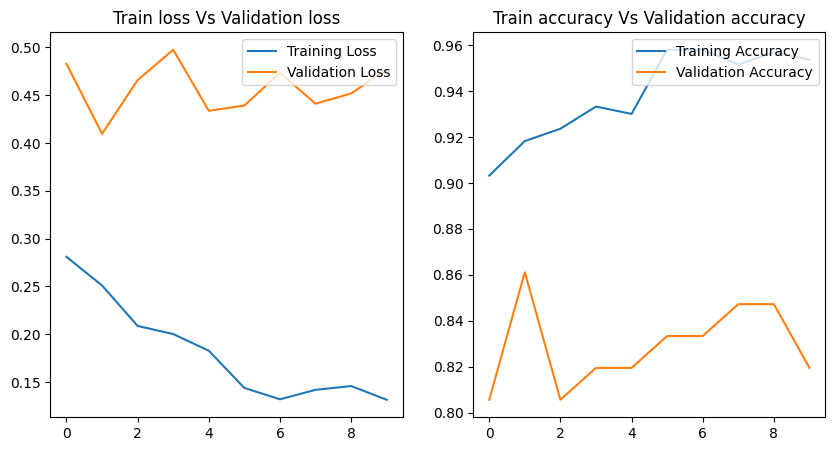

In [ ]:
train_loss = training.history['loss']
val_loss = training.history['val_loss']

train_acc = training.history['accuracy']
val_acc = training.history['val_accuracy']


# Plot the graphs
plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.plot( train_loss, label='Training Loss')
plt.plot( val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Train loss Vs Validation loss')

plt.subplot(1,2,2)
plt.plot( train_acc, label='Training Accuracy')
plt.plot( val_acc, label='Validation Accuracy')
plt.legend(loc='upper right')
plt.title('Train accuracy Vs Validation accuracy')

plt.show()

We see that after fine-tuning the model, it's accuracy has increased.

###Evaluate on test dataset

In [ ]:
test_eval = model.evaluate(test_ds)

print('PRE-TRAINED MODEL - FINE TUNED')
print('--------------------------------')
print('Test loss: {:.2f}'.format(test_eval[0]))
print('Test accuracy: {:.2f}%'.format(test_eval[1]*100))

5/5 [==============================] - 5s 915ms/step - loss: 0.6591 - accuracy: 0.8313
PRE-TRAINED MODEL - FINE TUNED
--------------------------------
Test loss: 0.66
Test accuracy: 83.13%


*****
####We see that, on fine-tuning a pre-trained model we were able to achieve an accuracy of **83.13%** on the test dataset.
*****

 - We see that after fine-tuning, the train and validation accuracy are much further apart and there has not been an imporovement in test accuracy after fine-tuning.
 - Hence we will not go for the fine tuned model.

## Launch TensorBoard

In [ ]:
# Model 1 - creating CNN from scratch
print('\033[1m                                   CNN from scratch')
print('                                   Accuracy: 32%')

%tensorboard --logdir logs1

                                   CNN from scratch
                                   Accuracy: 32%


<IPython.core.display.Javascript object>

In [ ]:
# Model 2a) - using pretrained model MobileNetV2

print('\033[1m                                   CNN using pretrained model')
print('                                   Accuracy: 32%')

%tensorboard --logdir logs2_1

                                   CNN using pretrained model
                                   Accuracy: 32%


<IPython.core.display.Javascript object>

In [ ]:
# Model 2b) - using pretrained model with fewer layers

print('\033[1m                                   CNN using pretrained model (few layers)')
print('                                   Accuracy: 32%')

%tensorboard --logdir logs2_2

                                   CNN using pretrained model (few layers)
                                   Accuracy: 32%


<IPython.core.display.Javascript object>

In [ ]:
# Model 3) - using fine-tuned model

print('\033[1m                                   CNN using pretrained model')
print('                                   Accuracy: 32%')

%tensorboard --logdir logs3

                                   CNN using pretrained model
                                   Accuracy: 32%


<IPython.core.display.Javascript object>

#Convert to TensorLite

Convert the final model to TensorLite to be deployed on mobile devices

In [ ]:
# Instantiate the TFLiteConverter and pass the final model to it
converter = tf.lite.TFLiteConverter.from_keras_model(model)

# Convert the model
model_tflite = converter.convert()

# Save the converted TFLite model
with open('model.tflite', 'wb') as f:
  f.write(model_tflite)

#Compare the results of both models built in steps 1 and 2 and state your observations.

Here is a summary of our results by experimenting with different models:

<br>

| Id | Model Desc | Accuracy |
|----------|----------|----------|
| 1 | Building a CNN from scratch | 31.25% |
| 2.1 | Using pre-trained model (MobilenetV2) | 81.25% |
| 2.2 | Using pre-trained model (with fewer layers) | 84.38% |
| 3 | Fine-tuning the pre-trained model | 83.13% |

We will select model **2.2: Using pre-trained model (with fewer layers)** for automating port operations as it gives the best performance with an accuracy of **84%**.

<br>

**Conclusions:**
- Using a pre-trained model like MobileNetV2 gives much better accuracy than training a model from scratch.
- Adding fewer layers on top of a pre-trained model gives better performance as it reduces complexity and prevents overfitting.
- Fine-tuning the pre-trained model may not always lead to better performance; it should be tried as per the use case at hand.




